## Load In Dependencies

In [36]:
# Supress Warnings
import warnings
warnings.filterwarnings('ignore')

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.basemap import Basemap
import folium

# Data Science
import numpy as np
import pandas as pd
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Multi-dimensional arrays and datasets
import xarray as xr

# Geospatial raster data handling
import rioxarray as rxr

# Geospatial data analysis
import geopandas as gpd

# Geospatial operations
import rasterio
from rasterio import windows  
from rasterio import features  
from rasterio import warp
from rasterio.warp import transform_bounds 
from rasterio.windows import from_bounds 

# Image Processing
from PIL import Image

# Coordinate transformations
from pyproj import Proj, Transformer, CRS

# Feature Engineering
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Machine Learning
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

# Planetary Computer Tools
import pystac_client
import planetary_computer as pc
from pystac.extensions.eo import EOExtension as eo

# Others
import os
from tqdm import tqdm


## Response Variable

Before building the model, we need to load in the Urban Heat Island (UHI) index training dataset. We have curated data for the New York region. The dataset consists of geo-locations (Longitude and Latitude), with additional fields including date & time of data collection and the UHI index for each location. 

In [2]:
# Load the training data from csv file and display the first few rows to inspect the data
ground_df = pd.read_csv("data/Training_data_uhi_index_UHI2025-v2.csv")
ground_df.head()

,Longitude,Latitude,datetime,UHI Index
0,-73.909167,40.813107,24-07-2021 15:53,1.030289
1,-73.909187,40.813045,24-07-2021 15:53,1.030289
2,-73.909215,40.812978,24-07-2021 15:53,1.023798
3,-73.909242,40.812908,24-07-2021 15:53,1.023798
4,-73.909257,40.812845,24-07-2021 15:53,1.021634


## Predictor Variables

### Downloading GeoTIFF Image

For building a sample model in this demonstration notebook, we have downloaded a GeoTIFF file locally for a single day (24th July 2021). The file is named <b>S2_sample.tiff</b>. This GeoTIFF file contains values of four bands: Band B01, Band B04, Band B06 and Band B08. In the subsequent section, we will use this GeoTIFF file to extract the band values for the geo-locations given in the training dataset to create the features.

First, let’s visualize the bands of the downloaded GeoTIFF image.

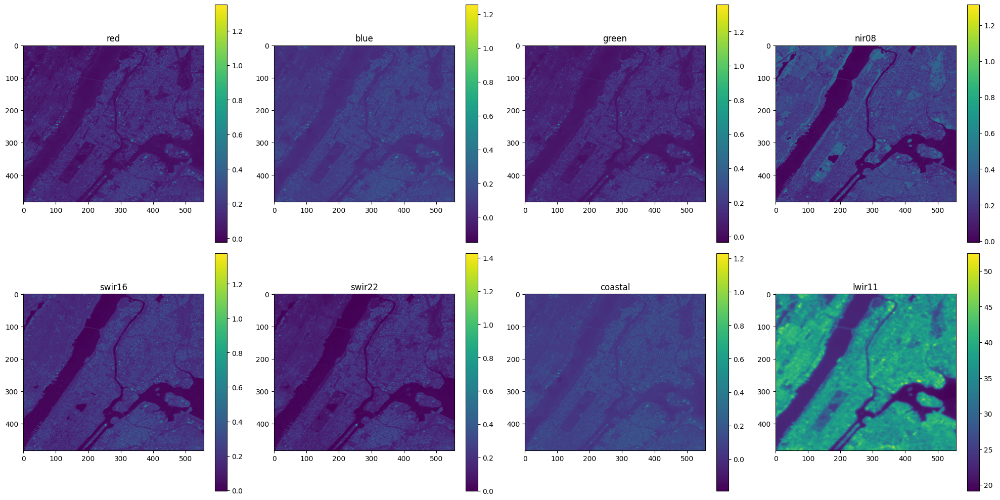

In [3]:
# Reads and plots four bands (B04, B08, B06, B01) from the GeoTIFF file.

# Open the GeoTIFF file
tiff_path = "data_pipeline/data/tiff/landsat_8.tiff"

# Read the bands from the GeoTIFF file
with rasterio.open(tiff_path) as dst:
    red = dst.read(1)
    blue = dst.read(2)
    green = dst.read(3)
    nir08 = dst.read(4)
    swir16 = dst.read(5)
    swir22 = dst.read(6)
    coastal = dst.read(7) 
    lwir11 = dst.read(8)

band_name = ['red', 'blue', 'green', 'nir08', 'swir16', 'swir22', 'coastal', 'lwir11'] 
band_lst = [red, blue, green, nir08, swir16, swir22, coastal, lwir11]
fig, axes = plt.subplots(2, 4, figsize=(20, 10))

# Flatten the axes for easier indexing
axes = axes.flatten()

for i in range(len(band_lst)):
    im = axes[i].imshow(band_lst[i], cmap='viridis')
    axes[i].set_title(band_name[i])
    fig.colorbar(im, ax=axes[i])

plt.tight_layout()
plt.show()


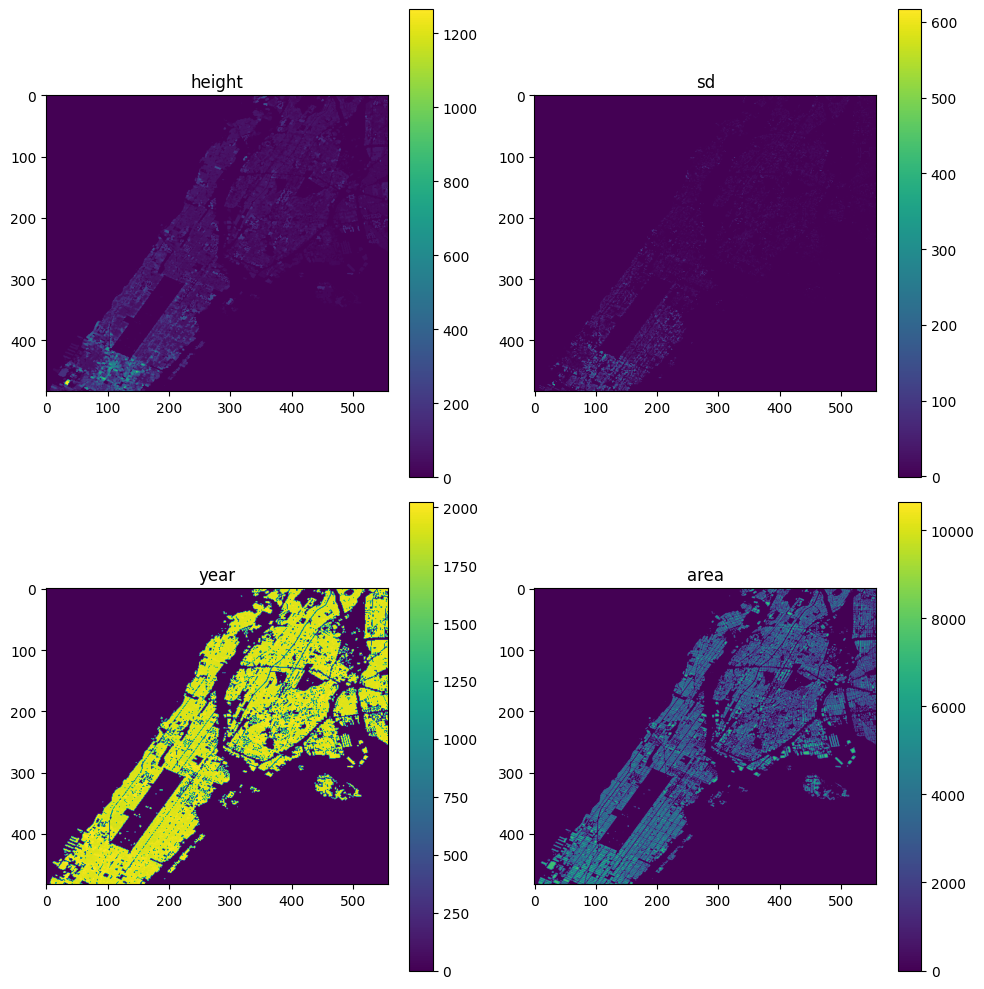

In [4]:
# Reads and plots four bands (B04, B08, B06, B01) from the GeoTIFF file.

# Open the GeoTIFF file
tiff_path = "data_pipeline/data/tiff/building_res30.tiff"

# Read the bands from the GeoTIFF file
with rasterio.open(tiff_path) as dst:
    building_height = dst.read(1)
    building_sd = dst.read(2)
    building_year = dst.read(3)
    building_area = dst.read(4)

band_name = ['height', 'sd', 'year', 'area']
band_lst = [building_height, building_sd, building_year, building_area]
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

# Flatten the axes for easier indexing
axes = axes.flatten()

for i in range(len(band_lst)):
    im = axes[i].imshow(band_lst[i], cmap='viridis')
    axes[i].set_title(band_name[i])
    fig.colorbar(im, ax=axes[i])

plt.tight_layout()
plt.show()


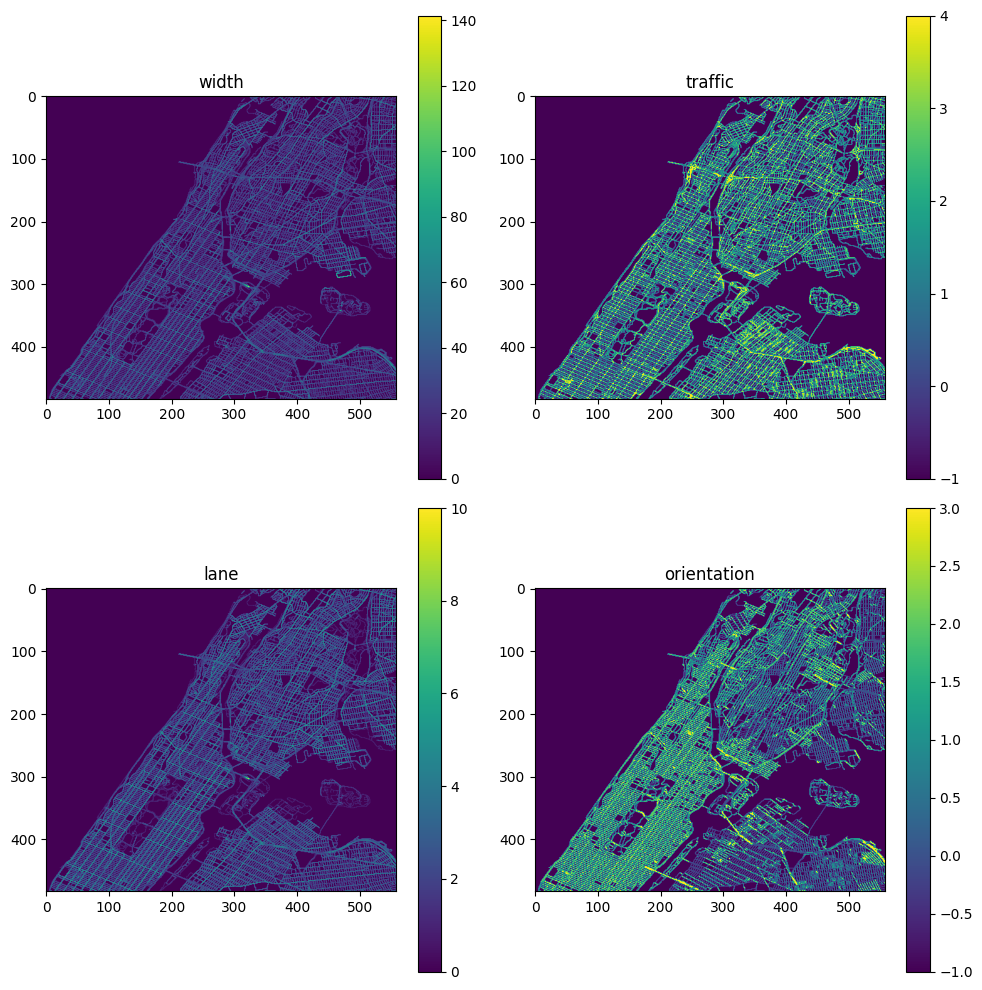

In [5]:
# Reads and plots four bands (B04, B08, B06, B01) from the GeoTIFF file.

# Open the GeoTIFF file
tiff_path = "data_pipeline/data/tiff/street_res30.tiff"

# Read the bands from the GeoTIFF file
with rasterio.open(tiff_path) as dst:
    street_width = dst.read(1)
    traffic_dir = dst.read(2)
    street_lane = dst.read(3)
    orientation = dst.read(4)
    bounds = dst.bounds
    
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

band_lst = [street_width, traffic_dir, street_lane, orientation]
band_name = ['width', 'traffic', 'lane', 'orientation']
# Flatten the axes for easier indexing
axes = axes.flatten()

for i in range(len(band_lst)):
    im = axes[i].imshow(band_lst[i], cmap='viridis')
    axes[i].set_title(band_name[i])
    fig.colorbar(im, ax=axes[i])

plt.tight_layout()
plt.show()


## Plotting

### Response

In [6]:
import branca.colormap as cm
# Create map
#  [-74.01, 40.75, -73.86, 40.88]
m = folium.Map(location=[40.8, -73.5], zoom_start=7)

colormap = cm.LinearColormap(["green", "yellow", "red"], vmin=ground_df["UHI Index"].min(), vmax=ground_df["UHI Index"].max())
# Add points
for _, row in ground_df.iterrows():
    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        radius=1,
        color=colormap(row["UHI Index"]), 
        fill=True,
        fill_opacity=0.7,
    ).add_to(m)

colormap.add_to(m)

m

### Predictors

In [7]:
# Extracts satellite band values from a GeoTIFF based on coordinates from a csv file and returns them in a DataFrame.

def map_satellite_data(tiff_path, csv_path, col_name):
    
    # Load the GeoTIFF data
    data = rxr.open_rasterio(tiff_path)
    layer_num = 0
    with rasterio.open(tiff_path) as dts:
        layer_num = dts.count

    # Read the Excel file using pandas
    df = pd.read_csv(csv_path)
    latitudes = df['Latitude'].values
    longitudes = df['Longitude'].values   

    df = pd.DataFrame()
    for i in tqdm(range(layer_num), desc="Go through layer"):
        values = []
        # Iterate over the latitudes and longitudes, and extract the corresponding band values
        for lat, lon in tqdm(zip(latitudes, longitudes), total=len(latitudes), desc="Mapping values"):
        # Assuming the correct dimensions are 'y' and 'x' (replace these with actual names from data.coords)
            cell_value = data.sel(x=lon, y=lat,  band=i+1, method="nearest").values
            values.append(cell_value)
        # Add column of feature
        df[col_name[i]] = values
    
    return df


In [8]:
# Mapping satellite data with training data.
data_dir = "data_pipeline/data/tiff/"
landsat_bands = ['red', 'blue', 'green', 'nir08', 'swir16', 'swir22', 'coastal', 'lwir11']
landsat_data = map_satellite_data(data_dir+'landsat_8.tiff', 'data/Training_data_uhi_index_UHI2025-v2.csv',
                                landsat_bands)

# Mapping satellite data with training data.
building_bands = ['building_height', 'building_sd', 'building_year', 'building_area']
building_data = map_satellite_data(data_dir+'building_res30.tiff', 'data/Training_data_uhi_index_UHI2025-v2.csv',
                                building_bands)

# Mapping satellite data with training data.
street_bands = ['street_width', 'street_traffic', 'street_lane', 'street_orientation']
street_data = map_satellite_data(data_dir+'street_res30.tiff', 'data/Training_data_uhi_index_UHI2025-v2.csv',
                                street_bands)

df = pd.read_csv('data/Training_data_uhi_index_UHI2025-v2.csv')
df = pd.concat([df, landsat_data, building_data, street_data], axis=1)
df.head()

Go through layer:   0%|          | 0/8 [00:00<?, ?it/s]


Go through layer: 100%|██████████| 4/4 [01:37<00:00, 24.37s/it]


,Longitude,Latitude,datetime,UHI Index,red,blue,green,nir08,swir16,swir22,coastal,lwir11,building_height,building_sd,building_year,building_area,street_width,street_traffic,street_lane,street_orientation
0,-73.909167,40.813107,24-07-2021 15:53,1.030289,0.0713975,0.04560249999999999,0.06952750000000002,0.20887,0.13649,0.09543249999999998,0.03925000000000001,37.78553354000002,65.1,0.0,1928.0,936.1115,44.0,4.0,4.0,1.0
1,-73.909187,40.813045,24-07-2021 15:53,1.030289,0.0713975,0.04560249999999999,0.06952750000000002,0.20887,0.13649,0.09543249999999998,0.03925000000000001,37.78553354000002,65.1,0.0,1928.0,936.1115,44.0,4.0,4.0,1.0
2,-73.909215,40.812978,24-07-2021 15:53,1.023798,0.10783500000000001,0.08875,0.10676249999999998,0.23001749999999999,0.185,0.1352525,0.07574249999999999,37.35828104000001,0.0,-1.0,0.0,0.0,31.0,1.0,2.3333333,1.0
3,-73.909242,40.812908,24-07-2021 15:53,1.023798,0.10783500000000001,0.08875,0.10676249999999998,0.23001749999999999,0.185,0.1352525,0.07574249999999999,37.35828104000001,0.0,-1.0,0.0,0.0,31.0,1.0,2.3333333,1.0
4,-73.909257,40.812845,24-07-2021 15:53,1.021634,0.10783500000000001,0.08875,0.10676249999999998,0.23001749999999999,0.185,0.1352525,0.07574249999999999,37.35828104000001,0.0,-1.0,0.0,0.0,31.0,1.0,2.3333333,1.0


In [19]:
from src.eda import EDA

df = df.drop(columns=['datetime']).astype('float')
df['street_traffic'] = df['street_traffic'].astype('int').astype('category')
df['street_orientation'] = df['street_orientation'].astype('int').astype('category')

stat_eda = EDA(df)
stat_eda.explore_stats()

,feature,data_type,n_distinct,n_missing,n_negative,n_zeros,count,unique,top,freq,mean,std,min,25%,50%,75%,max
0,Longitude,float64,10109 (90.03%),0 (0.00%),11229 (100.00%),0 (0.00%),11229.0,NaN,NaN,NaN,-73.933927,0.028253,-73.994457,-73.955703,-73.932968,-73.909647,-73.879458
1,Latitude,float64,9992 (88.98%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,40.808800,0.023171,40.758792,40.790905,40.810688,40.824515,40.859497
2,UHI Index,float64,595 (5.30%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,1.000001,0.016238,0.956122,0.988577,1.000237,1.011176,1.046036
3,red,float64,2828 (25.18%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.138309,0.052183,0.021512,0.106488,0.136298,0.166272,0.521600
4,blue,float64,2635 (23.47%),0 (0.00%),2 (0.02%),0 (0.00%),11229.0,NaN,NaN,NaN,0.107407,0.041744,-0.027108,0.080968,0.104370,0.128597,0.406045
5,green,float64,2711 (24.14%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.130044,0.045130,0.029213,0.101510,0.126177,0.152935,0.471687
6,nir08,float64,2962 (26.38%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.224469,0.059472,0.053138,0.183240,0.216735,0.257930,0.532407
7,swir16,float64,2749 (24.48%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.200798,0.050345,0.054485,0.167372,0.192123,0.226442,0.633030
8,swir22,float64,2832 (25.22%),0 (0.00%),0 (0.00%),0 (0.00%),11229.0,NaN,NaN,NaN,0.167788,0.054411,0.045960,0.131292,0.160855,0.195203,0.778587
9,coastal,float64,2534 (22.57%),0 (0.00%),15 (0.13%),0 (0.00%),11229.0,NaN,NaN,NaN,0.095621,0.037477,-0.036128,0.071947,0.092710,0.114435,0.364713


In [21]:
# Add features 
nir08 = df['nir08']
red = df['red']
green = df['green']
blue = df["blue"]
swir16 = df["swir16"]    
swir22 = df["swir22"] 

df["ndvi"] = (nir08 - red) / (nir08 + red + 1e-10)
df["evi"] = 2.5 * (nir08 - red) / (nir08 + 6 * red - 7.5 * blue + 1 + 1e-10)
df["savi"] = (nir08 - red) * 1.5 / (nir08 + red + 0.5 + 1e-10)
df["gndvi"] = (nir08 - green) / (nir08 + green + 1e-10)
df["arvi"] = (nir08 - (red - (blue - red))) / (nir08 + (red - (blue - red)) + 1e-10)
df["msavi"] = (2 * nir08 + 1 - np.sqrt((2 * nir08 + 1) ** 2 - 8 * (nir08 - red))) / 2

# Water Indices
df["ndwi"] = (green - nir08) / (green + nir08 + 1e-10)
df["mndwi"] = (green - swir16) / (green + swir16 + 1e-10)
df["awei_nsh"] = 4 * (green - swir16) - (0.25 * nir08 + 2.75 * swir22)
df["awei_sh"] = green + 2.5 * nir08 - 1.5 * (swir16 + swir22) - 0.25 * blue

# Soil and Snow Indices
df["ndsi"] = (green - swir16) / (green + swir16 + 1e-10)
df["nbr"] = (nir08 - swir22) / (nir08 + swir22 + 1e-10)

# Urban Indices
df["ndbi"] = (swir16 - nir08) / (swir16 + nir08 + 1e-10)
df["ui"] = (swir16 - red) / (swir16 + red + 1e-10)
df["ibi"] = (df["ndbi"] - (df["savi"] + df["mndwi"])) / \
                    (df["ndbi"] + (df["savi"] + df["mndwi"]) + 1e-10)

# Thermal & Climate Indices
df["si"] = (swir16 - blue) / (swir16 + blue + 1e-10)

# Albedo
df['albedo'] = (0.356 * df['blue'] + 0.130 * df['red'] + 0.373 * df['nir08'] + 0.085 * df['swir16'] + 0.072 * df['swir22'] - 0.018) / 1.016

# Building variance
df['var'] = df['building_height'] / df['street_width']
df['var'] = np.where(df['var'] == np.inf, np.nan, df['var'])

df.shape

(11229, 37)

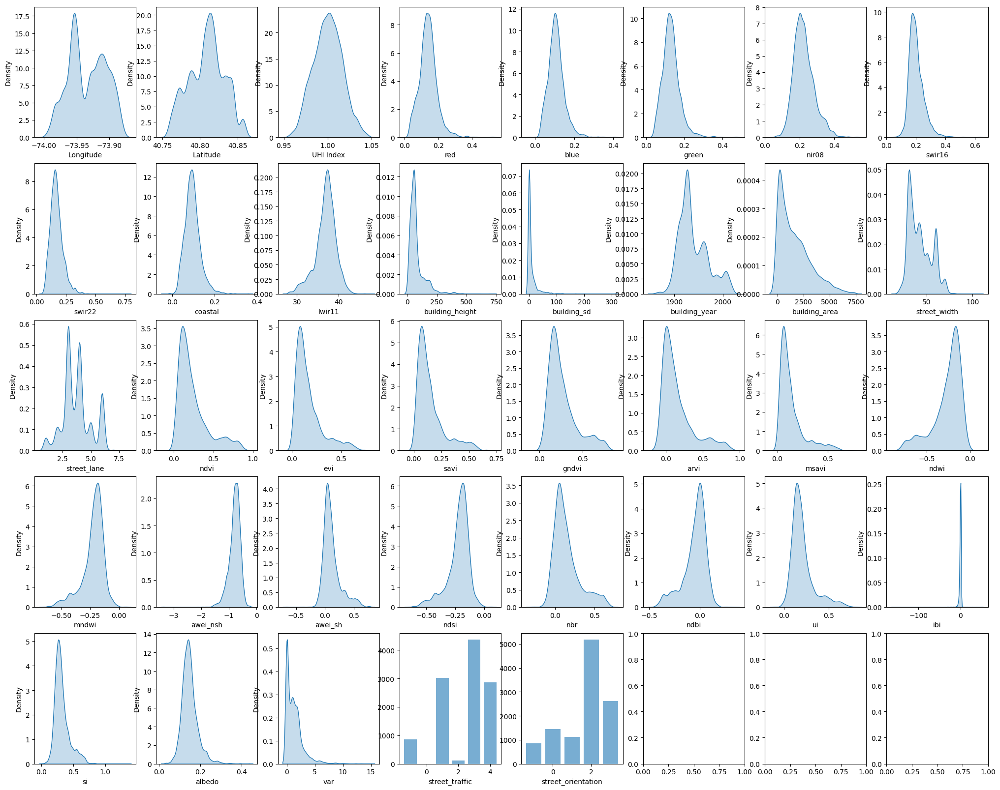

In [22]:
df_plot = df.copy()

df_plot['building_area'] = np.where(df_plot['building_area'] == 0, np.nan, df_plot['building_area'])
df_plot['building_height'] = np.where(df_plot['building_height'] == 0, np.nan, df_plot['building_height'])
df_plot['building_sd'] = np.where(df_plot['building_sd'] == -1, np.nan, df_plot['building_sd'])
df_plot['building_year'] = np.where(df_plot['building_year'] == 0, np.nan, df_plot['building_year'])
df_plot['street_width'] = np.where(df_plot['street_width'] == 0, np.nan, df_plot['street_width'])
df_plot['street_lane'] = np.where(df_plot['street_lane'] == 0, np.nan, df_plot['street_lane'])

# Identify numerical and categorical columns
num_cols = df_plot.select_dtypes(include=["number"]).columns.tolist()
cat_cols = df_plot.select_dtypes(exclude=["number"]).columns.tolist()

# Create Pair Plot Grid
fig, axes = plt.subplots(5, 8, figsize=(25, 20))
axes = axes.flatten()

# Iterate over all pairs
for i, col in enumerate(num_cols + cat_cols):
    ax = axes[i]

    if col in num_cols:
        sns.kdeplot(df_plot[col], fill=True, ax=ax)
    else:
        counts = df_plot[col].value_counts()
        ax.bar(counts.index, counts.values, alpha=0.6)
    
    ax.set_xlabel(col)

plt.show()

<Axes: >

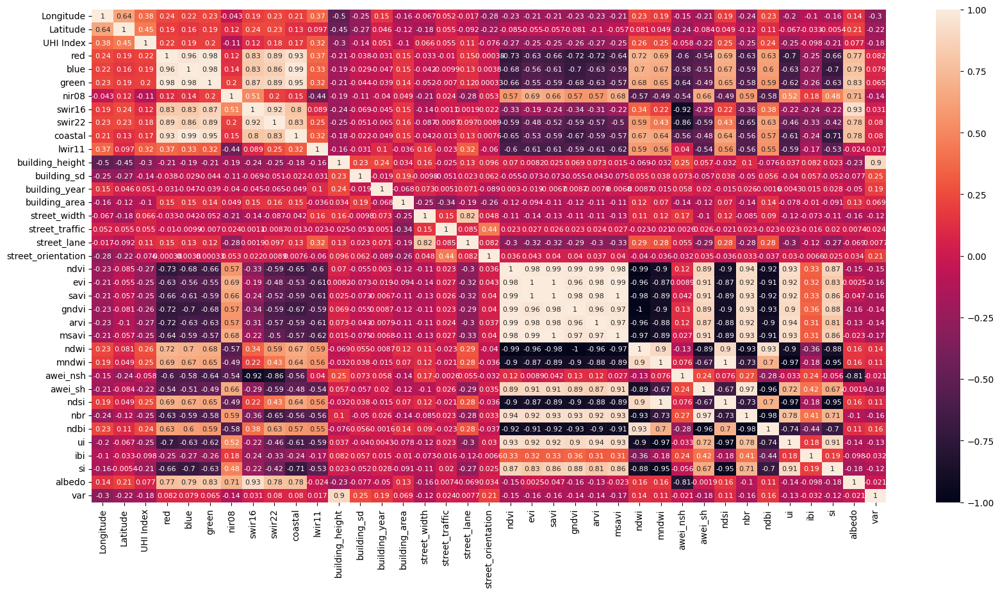

In [23]:
df_corr = df_plot.corr()

plt.figure(figsize=(20, 10))
sns.heatmap(df_corr, annot=True, annot_kws={"fontsize":8})

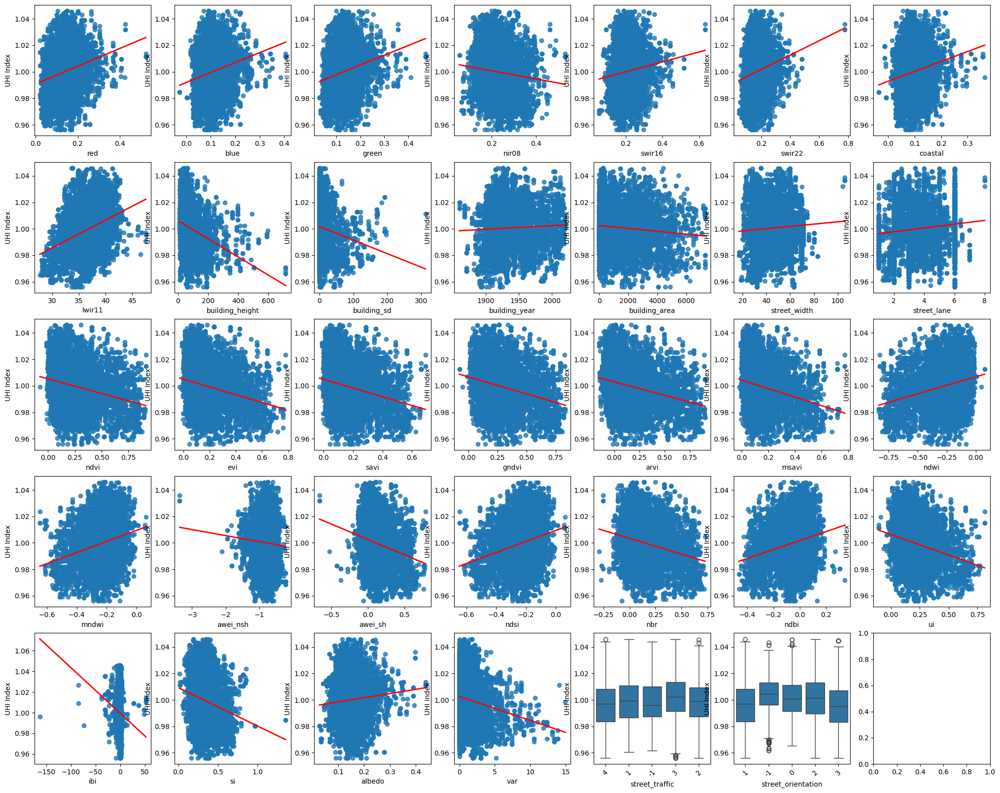

In [52]:
# Plot relationship with UHI index

# Identify numerical and categorical columns
num_cols = df_plot.drop(columns=['Longitude', 'Latitude', 'UHI Index']).select_dtypes(include=["number"]).columns.tolist()
cat_cols = df_plot.select_dtypes(exclude=["number"]).columns.tolist()

# Create Pair Plot Grid
fig, axes = plt.subplots(5, 7, figsize=(25, 20))
axes = axes.flatten()

# Iterate over all pairs
for i, col in enumerate(num_cols + cat_cols):
    ax = axes[i]

    if col in num_cols:

        sns.regplot(x=col, y="UHI Index", data=df_plot, ax=ax, ci=None, line_kws={'color': 'red', 'linewidth': 2})
    else:
        sns.boxplot(x=df[col], y=df['UHI Index'], ax=ax)
        ax.set_xticklabels(df[col].unique(), rotation=45)
    
    ax.set_xlabel(col)

plt.show()

## Feature engineering

In [151]:
pd.get_dummies(X_lasso['street_orientation'])

,-1,0,1,2,3
0,False,False,True,False,False
1,False,False,True,False,False
2,False,False,True,False,False
3,False,False,True,False,False
4,False,False,True,False,False
...,...,...,...,...,...
11224,False,False,False,True,False
11225,False,False,False,True,False
11226,False,False,False,True,False
11227,False,False,False,True,False


In [166]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from statsmodels.api import OLS

X_lasso = df.drop(columns=['UHI Index', 'Latitude', 'Longitude'])
X_lasso['var'] = X_lasso['var'].fillna(1000)

orientation = pd.get_dummies(X_lasso['street_orientation'], drop_first=True, prefix='orientation')
traffic = pd.get_dummies(X_lasso['street_traffic'], drop_first=True, prefix='traffic')
X_lasso = pd.concat([X_lasso, orientation, traffic], axis=1)
X_lasso = X_lasso.drop(columns=['street_orientation', 'street_traffic'])


scaler = StandardScaler()
X_lasso_scaled = pd.DataFrame(scaler.fit_transform(X_lasso), columns=X_lasso.columns)

X_lasso_scaled = sm.add_constant(X_lasso_scaled)

y = df['UHI Index']

# Fit LASSO using statsmodels OLS with L1 regularization
model = sm.OLS(y, X_lasso_scaled)
lasso_result = model.fit() 

In [167]:
print(lasso_result.summary())

                            OLS Regression Results                            
Dep. Variable:              UHI Index   R-squared:                       0.206
Model:                            OLS   Adj. R-squared:                  0.203
Method:                 Least Squares   F-statistic:                     85.25
Date:                Fri, 07 Feb 2025   Prob (F-statistic):               0.00
Time:                        05:02:45   Log-Likelihood:                 31628.
No. Observations:               11229   AIC:                        -6.319e+04
Df Residuals:                   11194   BIC:                        -6.293e+04
Df Model:                          34                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               1.0000      0.000   73

In [168]:
df_pred = df.copy()
df_pred['y_pred'] = lasso_result.predict(X_lasso_scaled)
df_pred['residual'] = y - df_pred['y_pred']

import branca.colormap as cm
# # Create map
# #  [-74.01, 40.75, -73.86, 40.88]
m = folium.Map(location=[40.8, -73.5], zoom_start=7)

colormap = cm.LinearColormap(["green", "yellow", "red"], vmin=df_pred['residual'].min(), vmax=df_pred['residual'].max())
# Add points
for _, row in df_pred.iterrows():
    folium.CircleMarker(
        location=[row["Latitude"], row["Longitude"]],
        radius=1,
        color=colormap(row["residual"]), 
        fill=True,
        fill_opacity=0.7,
    ).add_to(m)

colormap.add_to(m)

m

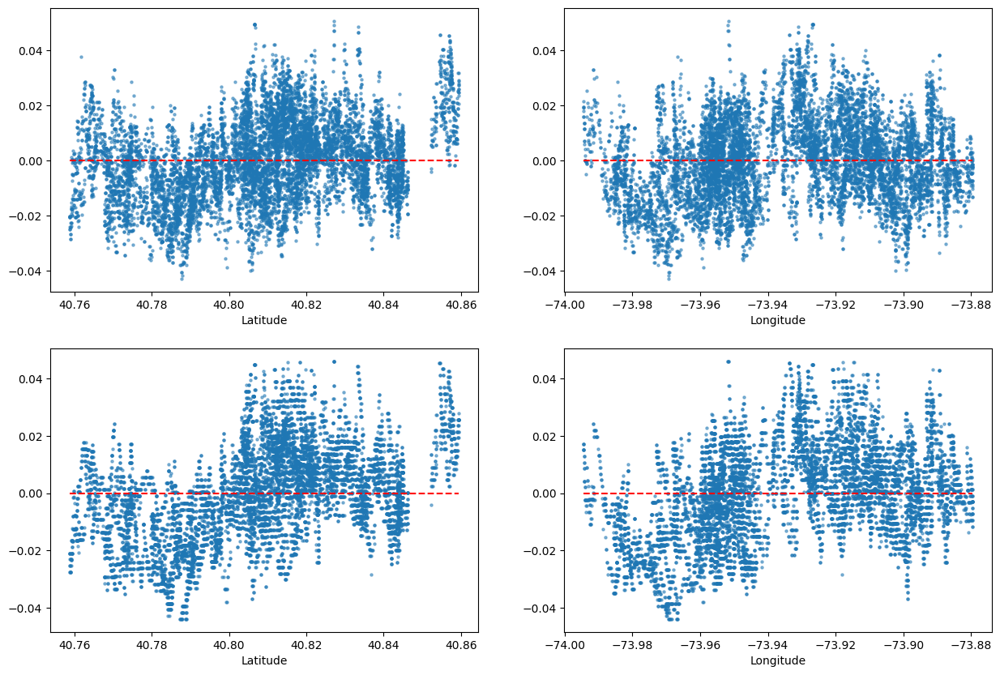

In [169]:
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
axes = axes.flatten()

axes[0].scatter(df['Latitude'], df_pred['residual'], alpha=0.5, s=5)
axes[0].hlines(y=0, xmin=df['Latitude'].min(), xmax=df['Latitude'].max(), color='red', linestyle='--')  # Reference line at y=0
axes[0].set_xlabel("Latitude")

axes[1].scatter(df['Longitude'], df_pred['residual'], alpha=0.5, s=5)
axes[1].hlines(y=0, xmin=df['Longitude'].min(), xmax=df['Longitude'].max(), color='red', linestyle='--')  # Reference line at y=0
axes[1].set_xlabel("Longitude")

axes[2].scatter(df['Latitude'], df_pred['UHI Index'] - df_pred['UHI Index'].mean(), alpha=0.5, s=5)
axes[2].hlines(y=0, xmin=df['Latitude'].min(), xmax=df['Latitude'].max(), color='red', linestyle='--')  # Reference line at y=0
axes[2].set_xlabel("Latitude")

axes[3].scatter(df['Longitude'], df_pred['UHI Index'] - df_pred['UHI Index'].mean(), alpha=0.5, s=5)
axes[3].hlines(y=0, xmin=df['Longitude'].min(), xmax=df['Longitude'].max(), color='red', linestyle='--')  # Reference line at y=0
axes[3].set_xlabel("Longitude")

plt.show()

In [ ]:
import libpysal
import esda
from splot.esda import moran_scatterplot
from shapely.geometry import Point

# Create spatial weights (5-nearest neighbors)
ground_df["geometry"] = ground_df.apply(lambda row: Point(row["Longitude"], row["Latitude"]), axis=1)
gdf = gpd.GeoDataFrame(ground_df, geometry="geometry", crs="EPSG:4326")

# fig, axes = plt.subplots(2, 3, figsize=(20, 15))
# axes = axes.flatten()


k_choices = [3, 5, 7, 9, 11, 15, 20, 25, 30]
i = 0

for k in k_choices:
    w = libpysal.weights.KNN.from_dataframe(gdf, k=k)
    w.transform = "R"  # Row standardization

    # Compute Moran's I
    moran = esda.Moran(gdf["UHI Index"], w)
    print(f"Moran's I: {moran.I}, p-value: {moran.p_sim}")

Moran's I: 0.9782149249899385, p-value: 0.001
Moran's I: 0.9692737233636249, p-value: 0.001
Moran's I: 0.9619088196659885, p-value: 0.001
Moran's I: 0.9551515844285662, p-value: 0.001
Moran's I: 0.9479585877267619, p-value: 0.001
Moran's I: 0.9336484130799709, p-value: 0.001
Moran's I: 0.9135081830669642, p-value: 0.001
Moran's I: 0.8943226576961534, p-value: 0.001
Moran's I: 0.8774720254329593, p-value: 0.001


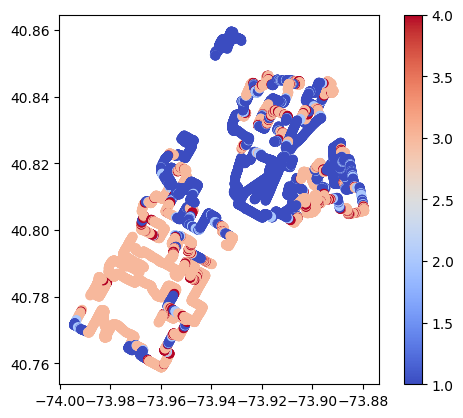

In [41]:
lisa = esda.Moran_Local(gdf["UHI Index"], w)

# Plot significant clusters
gdf["lisa_cluster"] = lisa.q
gdf.plot(column="lisa_cluster", cmap="coolwarm", legend=True)
plt.show()

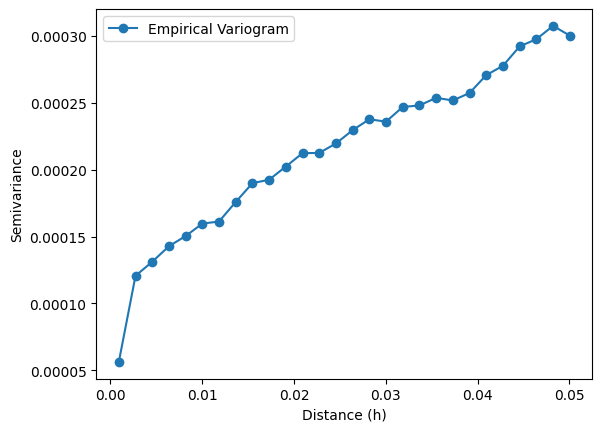

In [ ]:
import gstools as gs

# Define spatial coordinates
x, y = ground_df["Longitude"], ground_df["Latitude"]
z = ground_df["UHI Index"]

# Compute variogram
bin_center, gamma = gs.vario_estimate((x, y), z)

# Plot variogram
plt.plot(bin_center, gamma, "o-", label="Empirical Variogram")
plt.xlabel("Distance (h)")
plt.ylabel("Semivariance")
plt.legend()
plt.show()